In [1]:
!pwd

/teamspace/studios/this_studio


In [4]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [6]:
raw_df = pd.read_csv(os.path.join(DATA_ROOT, 'raw/uber-fare-NewYorkCity.csv'))
# raw_df = pd.read_csv(r"E:\Projects\MLOPS\nyc-uber\NYC-uber-fare-rate\data\raw\uber-fare-NewYorkCity.csv")
raw_df.sample(5)

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
96470,39107288,2015-02-04 12:32:49.0000002,10.0,2015-02-04 12:32:49 UTC,-73.992577,40.754196,-73.982422,40.746719,3
153382,21301563,2015-03-16 18:36:58.0000005,8.5,2015-03-16 18:36:58 UTC,-73.989159,40.741348,-73.977592,40.726681,6
190198,45446468,2012-12-01 11:52:45.0000002,6.0,2012-12-01 11:52:45 UTC,-73.987363,40.754918,-73.984868,40.747777,4
145495,24956828,2014-08-15 10:11:08.0000003,7.0,2014-08-15 10:11:08 UTC,-73.976777,40.764825,-73.983417,40.750129,1
67725,35238656,2011-12-13 12:48:07.0000002,9.7,2011-12-13 12:48:07 UTC,-73.959000,40.775200,-73.975700,40.780500,2


In [7]:
print(raw_df.shape), raw_df.info()

(200000, 9)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 9 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         200000 non-null  int64  
 1   key                200000 non-null  object 
 2   fare_amount        200000 non-null  float64
 3   pickup_datetime    200000 non-null  object 
 4   pickup_longitude   200000 non-null  float64
 5   pickup_latitude    200000 non-null  float64
 6   dropoff_longitude  199999 non-null  float64
 7   dropoff_latitude   199999 non-null  float64
 8   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(2), object(2)
memory usage: 13.7+ MB


(None, None)

In [8]:
raw_df.describe()

,Unnamed: 0,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,2.000000e+05,200000.000000,200000.000000,200000.000000,199999.000000,199999.000000,200000.000000
mean,2.771250e+07,11.359955,-72.527638,39.935885,-72.525292,39.923890,1.684535
std,1.601382e+07,9.901776,11.437787,7.720539,13.117408,6.794829,1.385997
min,1.000000e+00,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,1.382535e+07,6.000000,-73.992065,40.734796,-73.991407,40.733823,1.000000
50%,2.774550e+07,8.500000,-73.981823,40.752592,-73.980093,40.753042,1.000000
75%,4.155530e+07,12.500000,-73.967154,40.767158,-73.963658,40.768001,2.000000
max,5.542357e+07,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


In [9]:
df = raw_df.dropna()

In [10]:
df

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5
...,...,...,...,...,...,...,...,...,...
199995,42598914,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1
199996,16382965,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1
199997,27804658,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2
199998,20259894,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1


In [11]:
for col in df.columns:
    print(f"{col}: ",df[col].nunique())

Unnamed: 0:  199999
key:  199999
fare_amount:  1244
pickup_datetime:  196628
pickup_longitude:  71065
pickup_latitude:  83835
dropoff_longitude:  76894
dropoff_latitude:  90585
passenger_count:  8


In [12]:
from ydata_profiling import ProfileReport

In [13]:
profile = ProfileReport(df, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
df.columns

Index(['Unnamed: 0', 'key', 'fare_amount', 'pickup_datetime',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'passenger_count'],
      dtype='object')

In [15]:
df = df.drop(['Unnamed: 0', 'key'], axis=1)
print(df.shape)
df.columns

(199999, 7)


Index(['fare_amount', 'pickup_datetime', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'passenger_count'],
      dtype='object')

In [16]:
df[df['passenger_count'] == 0]

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
333,10.1,2011-08-05 07:03:08 UTC,-74.013900,40.707800,-73.992300,40.749300,0
908,11.7,2011-09-06 12:25:19 UTC,-73.981000,40.764600,-73.962900,40.778400,0
926,3.3,2012-03-26 18:11:24 UTC,-73.979978,40.765821,-73.983894,40.766873,0
2000,15.7,2012-04-20 15:07:57 UTC,-73.975285,40.750138,-73.974729,40.783151,0
3011,6.1,2012-01-07 19:19:08 UTC,-73.977900,40.789100,-73.983700,40.773600,0
...,...,...,...,...,...,...,...
196797,3.3,2011-01-17 15:52:26 UTC,-74.000760,40.757637,-74.004852,40.751947,0
197103,7.3,2011-12-10 15:33:12 UTC,0.000000,0.000000,0.000000,0.000000,0
198872,5.7,2011-09-20 19:55:05 UTC,-73.980300,40.742800,-73.967900,40.755600,0
198902,12.1,2011-08-22 21:10:56 UTC,-73.996700,40.737200,-74.008500,40.704000,0


# Outlier Detection

In [23]:
def plot_outlier(columns):
  ax = columns.plot(kind = 'box', title = 'boxplot', showmeans = True)
  plt.grid()
  plt.show()


In [18]:
import plotly.graph_objects as go

def plotly_plot_outlier(df, column):
    # Create a Plotly box plot
    fig = go.Figure()
    for col in df.column:
        fig.add_trace(go.Box(y=df[col], name=column, boxmean='sd'))

    # Customize layout
    fig.update_layout(title='Boxplot', showlegend=True, boxmode='group')

    fig.show()

In [19]:
plot_outlier(df['fare_amount'])

In [20]:
# plotly_plot_outlier(df, 'fare_amount')

In [24]:
plot_outlier(df['passenger_count'])

ValueError: The number of FixedLocator locations (4), usually from a call to set_ticks, does not match the number of labels (1).

In [ ]:
# plotly_plot_outlier(df, 'passenger_count')

In [ ]:
df.columns

Index(['fare_amount', 'pickup_datetime', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'passenger_count'],
      dtype='object')

In [ ]:
plot_outlier(df[['pickup_longitude', 'dropoff_longitude']])

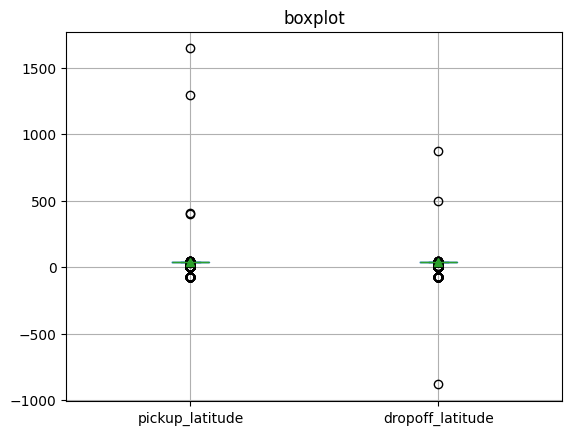

In [ ]:
plot_outlier(df[['pickup_latitude', 'dropoff_latitude']])

In [25]:
df.columns

Index(['fare_amount', 'pickup_datetime', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'passenger_count'],
      dtype='object')

In [26]:
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])
df['pickup_datetime'] = df['pickup_datetime'].dt.strftime("%Y-%m-%d %H:%M")
df['pickup_datetime'] = pd.to_datetime(df['pickup_datetime'])

In [27]:
df.columns

Index(['fare_amount', 'pickup_datetime', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'passenger_count'],
      dtype='object')

In [28]:
sns.distplot(df['fare_amount'], bins=50, kde=True)


<Axes: title={'center': 'boxplot'}, xlabel='fare_amount', ylabel='Density'>

In [29]:
fare_amount = df['fare_amount']

fig = go.Figure(data=go.Histogram(x=fare_amount, nbinsx=50, histnorm='probability', kde=True))

# Update layout
fig.update_layout(
    title='Distribution of Fare Amount',
    xaxis=dict(title='Fare Amount'),
    yaxis=dict(title='Probability Density')
)

fig.show()

ValueError: Invalid property specified for object of type plotly.graph_objs.Histogram: 'kde'

Did you mean "ids"?

    Valid properties:
        alignmentgroup
            Set several traces linked to the same position axis or
            matching axes to the same alignmentgroup. This controls
            whether bars compute their positional range dependently
            or independently.
        autobinx
            Obsolete: since v1.42 each bin attribute is auto-
            determined separately and `autobinx` is not needed.
            However, we accept `autobinx: true` or `false` and will
            update `xbins` accordingly before deleting `autobinx`
            from the trace.
        autobiny
            Obsolete: since v1.42 each bin attribute is auto-
            determined separately and `autobiny` is not needed.
            However, we accept `autobiny: true` or `false` and will
            update `ybins` accordingly before deleting `autobiny`
            from the trace.
        bingroup
            Set a group of histogram traces which will have
            compatible bin settings. Note that traces on the same
            subplot and with the same "orientation" under `barmode`
            "stack", "relative" and "group" are forced into the
            same bingroup, Using `bingroup`, traces under `barmode`
            "overlay" and on different axes (of the same axis type)
            can have compatible bin settings. Note that histogram
            and histogram2d* trace can share the same `bingroup`
        cliponaxis
            Determines whether the text nodes are clipped about the
            subplot axes. To show the text nodes above axis lines
            and tick labels, make sure to set `xaxis.layer` and
            `yaxis.layer` to *below traces*.
        constraintext
            Constrain the size of text inside or outside a bar to
            be no larger than the bar itself.
        cumulative
            :class:`plotly.graph_objects.histogram.Cumulative`
            instance or dict with compatible properties
        customdata
            Assigns extra data each datum. This may be useful when
            listening to hover, click and selection events. Note
            that, "scatter" traces also appends customdata items in
            the markers DOM elements
        customdatasrc
            Sets the source reference on Chart Studio Cloud for
            `customdata`.
        error_x
            :class:`plotly.graph_objects.histogram.ErrorX` instance
            or dict with compatible properties
        error_y
            :class:`plotly.graph_objects.histogram.ErrorY` instance
            or dict with compatible properties
        histfunc
            Specifies the binning function used for this histogram
            trace. If "count", the histogram values are computed by
            counting the number of values lying inside each bin. If
            "sum", "avg", "min", "max", the histogram values are
            computed using the sum, the average, the minimum or the
            maximum of the values lying inside each bin
            respectively.
        histnorm
            Specifies the type of normalization used for this
            histogram trace. If "", the span of each bar
            corresponds to the number of occurrences (i.e. the
            number of data points lying inside the bins). If
            "percent" / "probability", the span of each bar
            corresponds to the percentage / fraction of occurrences
            with respect to the total number of sample points
            (here, the sum of all bin HEIGHTS equals 100% / 1). If
            "density", the span of each bar corresponds to the
            number of occurrences in a bin divided by the size of
            the bin interval (here, the sum of all bin AREAS equals
            the total number of sample points). If *probability
            density*, the area of each bar corresponds to the
            probability that an event will fall into the
            corresponding bin (here, the sum of all bin AREAS
            equals 1).
        hoverinfo
            Determines which trace information appear on hover. If
            `none` or `skip` are set, no information is displayed
            upon hovering. But, if `none` is set, click and hover
            events are still fired.
        hoverinfosrc
            Sets the source reference on Chart Studio Cloud for
            `hoverinfo`.
        hoverlabel
            :class:`plotly.graph_objects.histogram.Hoverlabel`
            instance or dict with compatible properties
        hovertemplate
            Template string used for rendering the information that
            appear on hover box. Note that this will override
            `hoverinfo`. Variables are inserted using %{variable},
            for example "y: %{y}" as well as %{xother}, {%_xother},
            {%_xother_}, {%xother_}. When showing info for several
            points, "xother" will be added to those with different
            x positions from the first point. An underscore before
            or after "(x|y)other" will add a space on that side,
            only when this field is shown. Numbers are formatted
            using d3-format's syntax %{variable:d3-format}, for
            example "Price: %{y:$.2f}".
            https://github.com/d3/d3-format/tree/v1.4.5#d3-format
            for details on the formatting syntax. Dates are
            formatted using d3-time-format's syntax
            %{variable|d3-time-format}, for example "Day:
            %{2019-01-01|%A}". https://github.com/d3/d3-time-
            format/tree/v2.2.3#locale_format for details on the
            date formatting syntax. The variables available in
            `hovertemplate` are the ones emitted as event data
            described at this link
            https://plotly.com/javascript/plotlyjs-events/#event-
            data. Additionally, every attributes that can be
            specified per-point (the ones that are `arrayOk: true`)
            are available. Finally, the template string has access
            to variable `binNumber` Anything contained in tag
            `<extra>` is displayed in the secondary box, for
            example "<extra>{fullData.name}</extra>". To hide the
            secondary box completely, use an empty tag
            `<extra></extra>`.
        hovertemplatesrc
            Sets the source reference on Chart Studio Cloud for
            `hovertemplate`.
        hovertext
            Same as `text`.
        hovertextsrc
            Sets the source reference on Chart Studio Cloud for
            `hovertext`.
        ids
            Assigns id labels to each datum. These ids for object
            constancy of data points during animation. Should be an
            array of strings, not numbers or any other type.
        idssrc
            Sets the source reference on Chart Studio Cloud for
            `ids`.
        insidetextanchor
            Determines if texts are kept at center or start/end
            points in `textposition` "inside" mode.
        insidetextfont
            Sets the font used for `text` lying inside the bar.
        legend
            Sets the reference to a legend to show this trace in.
            References to these legends are "legend", "legend2",
            "legend3", etc. Settings for these legends are set in
            the layout, under `layout.legend`, `layout.legend2`,
            etc.
        legendgroup
            Sets the legend group for this trace. Traces and shapes
            part of the same legend group hide/show at the same
            time when toggling legend items.
        legendgrouptitle
            :class:`plotly.graph_objects.histogram.Legendgrouptitle
            ` instance or dict with compatible properties
        legendrank
            Sets the legend rank for this trace. Items and groups
            with smaller ranks are presented on top/left side while
            with "reversed" `legend.traceorder` they are on
            bottom/right side. The default legendrank is 1000, so
            that you can use ranks less than 1000 to place certain
            items before all unranked items, and ranks greater than
            1000 to go after all unranked items. When having
            unranked or equal rank items shapes would be displayed
            after traces i.e. according to their order in data and
            layout.
        legendwidth
            Sets the width (in px or fraction) of the legend for
            this trace.
        marker
            :class:`plotly.graph_objects.histogram.Marker` instance
            or dict with compatible properties
        meta
            Assigns extra meta information associated with this
            trace that can be used in various text attributes.
            Attributes such as trace `name`, graph, axis and
            colorbar `title.text`, annotation `text`
            `rangeselector`, `updatemenues` and `sliders` `label`
            text all support `meta`. To access the trace `meta`
            values in an attribute in the same trace, simply use
            `%{meta[i]}` where `i` is the index or key of the
            `meta` item in question. To access trace `meta` in
            layout attributes, use `%{data[n[.meta[i]}` where `i`
            is the index or key of the `meta` and `n` is the trace
            index.
        metasrc
            Sets the source reference on Chart Studio Cloud for
            `meta`.
        name
            Sets the trace name. The trace name appears as the
            legend item and on hover.
        nbinsx
            Specifies the maximum number of desired bins. This
            value will be used in an algorithm that will decide the
            optimal bin size such that the histogram best
            visualizes the distribution of the data. Ignored if
            `xbins.size` is provided.
        nbinsy
            Specifies the maximum number of desired bins. This
            value will be used in an algorithm that will decide the
            optimal bin size such that the histogram best
            visualizes the distribution of the data. Ignored if
            `ybins.size` is provided.
        offsetgroup
            Set several traces linked to the same position axis or
            matching axes to the same offsetgroup where bars of the
            same position coordinate will line up.
        opacity
            Sets the opacity of the trace.
        orientation
            Sets the orientation of the bars. With "v" ("h"), the
            value of the each bar spans along the vertical
            (horizontal).
        outsidetextfont
            Sets the font used for `text` lying outside the bar.
        selected
            :class:`plotly.graph_objects.histogram.Selected`
            instance or dict with compatible properties
        selectedpoints
            Array containing integer indices of selected points.
            Has an effect only for traces that support selections.
            Note that an empty array means an empty selection where
            the `unselected` are turned on for all points, whereas,
            any other non-array values means no selection all where
            the `selected` and `unselected` styles have no effect.
        showlegend
            Determines whether or not an item corresponding to this
            trace is shown in the legend.
        stream
            :class:`plotly.graph_objects.histogram.Stream` instance
            or dict with compatible properties
        text
            Sets hover text elements associated with each bar. If a
            single string, the same string appears over all bars.
            If an array of string, the items are mapped in order to
            the this trace's coordinates.
        textangle
            Sets the angle of the tick labels with respect to the
            bar. For example, a `tickangle` of -90 draws the tick
            labels vertically. With "auto" the texts may
            automatically be rotated to fit with the maximum size
            in bars.
        textfont
            Sets the text font.
        textposition
            Specifies the location of the `text`. "inside"
            positions `text` inside, next to the bar end (rotated
            and scaled if needed). "outside" positions `text`
            outside, next to the bar end (scaled if needed), unless
            there is another bar stacked on this one, then the text
            gets pushed inside. "auto" tries to position `text`
            inside the bar, but if the bar is too small and no bar
            is stacked on this one the text is moved outside. If
            "none", no text appears.
        textsrc
            Sets the source reference on Chart Studio Cloud for
            `text`.
        texttemplate
            Template string used for rendering the information text
            that appear on points. Note that this will override
            `textinfo`. Variables are inserted using %{variable},
            for example "y: %{y}". Numbers are formatted using
            d3-format's syntax %{variable:d3-format}, for example
            "Price: %{y:$.2f}".
            https://github.com/d3/d3-format/tree/v1.4.5#d3-format
            for details on the formatting syntax. Dates are
            formatted using d3-time-format's syntax
            %{variable|d3-time-format}, for example "Day:
            %{2019-01-01|%A}". https://github.com/d3/d3-time-
            format/tree/v2.2.3#locale_format for details on the
            date formatting syntax. Every attributes that can be
            specified per-point (the ones that are `arrayOk: true`)
            are available. Finally, the template string has access
            to variables `label` and `value`.
        uid
            Assign an id to this trace, Use this to provide object
            constancy between traces during animations and
            transitions.
        uirevision
            Controls persistence of some user-driven changes to the
            trace: `constraintrange` in `parcoords` traces, as well
            as some `editable: true` modifications such as `name`
            and `colorbar.title`. Defaults to `layout.uirevision`.
            Note that other user-driven trace attribute changes are
            controlled by `layout` attributes: `trace.visible` is
            controlled by `layout.legend.uirevision`,
            `selectedpoints` is controlled by
            `layout.selectionrevision`, and `colorbar.(x|y)`
            (accessible with `config: {editable: true}`) is
            controlled by `layout.editrevision`. Trace changes are
            tracked by `uid`, which only falls back on trace index
            if no `uid` is provided. So if your app can add/remove
            traces before the end of the `data` array, such that
            the same trace has a different index, you can still
            preserve user-driven changes if you give each trace a
            `uid` that stays with it as it moves.
        unselected
            :class:`plotly.graph_objects.histogram.Unselected`
            instance or dict with compatible properties
        visible
            Determines whether or not this trace is visible. If
            "legendonly", the trace is not drawn, but can appear as
            a legend item (provided that the legend itself is
            visible).
        x
            Sets the sample data to be binned on the x axis.
        xaxis
            Sets a reference between this trace's x coordinates and
            a 2D cartesian x axis. If "x" (the default value), the
            x coordinates refer to `layout.xaxis`. If "x2", the x
            coordinates refer to `layout.xaxis2`, and so on.
        xbins
            :class:`plotly.graph_objects.histogram.XBins` instance
            or dict with compatible properties
        xcalendar
            Sets the calendar system to use with `x` date data.
        xhoverformat
            Sets the hover text formatting rulefor `x`  using d3
            formatting mini-languages which are very similar to
            those in Python. For numbers, see:
            https://github.com/d3/d3-format/tree/v1.4.5#d3-format.
            And for dates see: https://github.com/d3/d3-time-
            format/tree/v2.2.3#locale_format. We add two items to
            d3's date formatter: "%h" for half of the year as a
            decimal number as well as "%{n}f" for fractional
            seconds with n digits. For example, *2016-10-13
            09:15:23.456* with tickformat "%H~%M~%S.%2f" would
            display *09~15~23.46*By default the values are
            formatted using `xaxis.hoverformat`.
        xsrc
            Sets the source reference on Chart Studio Cloud for
            `x`.
        y
            Sets the sample data to be binned on the y axis.
        yaxis
            Sets a reference between this trace's y coordinates and
            a 2D cartesian y axis. If "y" (the default value), the
            y coordinates refer to `layout.yaxis`. If "y2", the y
            coordinates refer to `layout.yaxis2`, and so on.
        ybins
            :class:`plotly.graph_objects.histogram.YBins` instance
            or dict with compatible properties
        ycalendar
            Sets the calendar system to use with `y` date data.
        yhoverformat
            Sets the hover text formatting rulefor `y`  using d3
            formatting mini-languages which are very similar to
            those in Python. For numbers, see:
            https://github.com/d3/d3-format/tree/v1.4.5#d3-format.
            And for dates see: https://github.com/d3/d3-time-
            format/tree/v2.2.3#locale_format. We add two items to
            d3's date formatter: "%h" for half of the year as a
            decimal number as well as "%{n}f" for fractional
            seconds with n digits. For example, *2016-10-13
            09:15:23.456* with tickformat "%H~%M~%S.%2f" would
            display *09~15~23.46*By default the values are
            formatted using `yaxis.hoverformat`.
        ysrc
            Sets the source reference on Chart Studio Cloud for
            `y`.
        
Did you mean "ids"?

Bad property path:
kde
^^^

In [ ]:
sns.displot(df['pickup_longitude'], bins=50, kde=True)

In [30]:
def outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    print("Column: ",column)
    print("\tIQR: ",IQR)
    print("\tower bound: ",lower_bound)
    print("\tUpper bound: ",upper_bound)
    return df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

In [31]:
outliers_iqr(df, 'fare_amount')

Column:  fare_amount
	IQR:  6.5
	ower bound:  -3.75
	Upper bound:  22.25


,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.5,2015-05-07 19:52:00,-73.999817,40.738354,-73.999512,40.723217,1
1,7.7,2009-07-17 20:04:00,-73.994355,40.728225,-73.994710,40.750325,1
2,12.9,2009-08-24 21:45:00,-74.005043,40.740770,-73.962565,40.772647,1
3,5.3,2009-06-26 08:22:00,-73.976124,40.790844,-73.965316,40.803349,3
4,16.0,2014-08-28 17:47:00,-73.925023,40.744085,-73.973082,40.761247,5
...,...,...,...,...,...,...,...
199994,12.0,2014-01-31 14:42:00,-73.983070,40.760770,-73.972972,40.754177,1
199995,3.0,2012-10-28 10:49:00,-73.987042,40.739367,-73.986525,40.740297,1
199996,7.5,2014-03-14 01:09:00,-73.984722,40.736837,-74.006672,40.739620,1
199998,14.5,2015-05-20 14:56:00,-73.997124,40.725452,-73.983215,40.695415,1


In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 199999 entries, 0 to 199999
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   fare_amount        199999 non-null  float64       
 1   pickup_datetime    199999 non-null  datetime64[ns]
 2   pickup_longitude   199999 non-null  float64       
 3   pickup_latitude    199999 non-null  float64       
 4   dropoff_longitude  199999 non-null  float64       
 5   dropoff_latitude   199999 non-null  float64       
 6   passenger_count    199999 non-null  int64         
dtypes: datetime64[ns](1), float64(5), int64(1)
memory usage: 12.2 MB


In [33]:
df = outliers_iqr(df, 'fare_amount')
df = outliers_iqr(df, 'pickup_longitude')
df = outliers_iqr(df, 'pickup_latitude')
df = outliers_iqr(df, 'dropoff_longitude')
df = outliers_iqr(df, 'dropoff_latitude')
# df = outliers_iqr(df, 'passenger_count')

df.shape

Column:  fare_amount
	IQR:  6.5
	ower bound:  -3.75
	Upper bound:  22.25
Column:  pickup_longitude
	IQR:  0.023301999999986833
	ower bound:  -74.02730999999997
	Upper bound:  -73.93410200000002
Column:  pickup_latitude
	IQR:  0.029510000000001924
	ower bound:  40.692913499999996
	Upper bound:  40.810953500000004
Column:  dropoff_longitude
	IQR:  0.022909023925762995
	ower bound:  -74.02637303588864
	Upper bound:  -73.93473694018559
Column:  dropoff_latitude
	IQR:  0.030220132690431
	ower bound:  40.692080800964355
	Upper bound:  40.81296133172608


(166874, 7)

In [34]:
print(df['passenger_count'].value_counts())
sns.countplot(x='passenger_count', data = df)


passenger_count
1      115658
2       24337
5       11639
3        7466
4        3595
6        3565
0         613
208         1
Name: count, dtype: int64


<Axes: title={'center': 'boxplot'}, xlabel='passenger_count', ylabel='count'>

In [35]:
# still we have passenger values with 0, so we will remove them

df[df['passenger_count'] >=1]

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,7.5,2015-05-07 19:52:00,-73.999817,40.738354,-73.999512,40.723217,1
1,7.7,2009-07-17 20:04:00,-73.994355,40.728225,-73.994710,40.750325,1
2,12.9,2009-08-24 21:45:00,-74.005043,40.740770,-73.962565,40.772647,1
3,5.3,2009-06-26 08:22:00,-73.976124,40.790844,-73.965316,40.803349,3
5,4.9,2011-02-12 02:27:00,-73.969019,40.755910,-73.969019,40.755910,1
...,...,...,...,...,...,...,...
199994,12.0,2014-01-31 14:42:00,-73.983070,40.760770,-73.972972,40.754177,1
199995,3.0,2012-10-28 10:49:00,-73.987042,40.739367,-73.986525,40.740297,1
199996,7.5,2014-03-14 01:09:00,-73.984722,40.736837,-74.006672,40.739620,1
199998,14.5,2015-05-20 14:56:00,-73.997124,40.725452,-73.983215,40.695415,1


In [36]:
df[df['passenger_count'] == 208]

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
113038,11.7,2010-12-28 08:20:00,-73.937795,40.758498,-73.937835,40.758415,208


In [37]:
df =df[df['passenger_count'] >= 1]
df =df.drop(index=113038)
df.shape

(166260, 7)

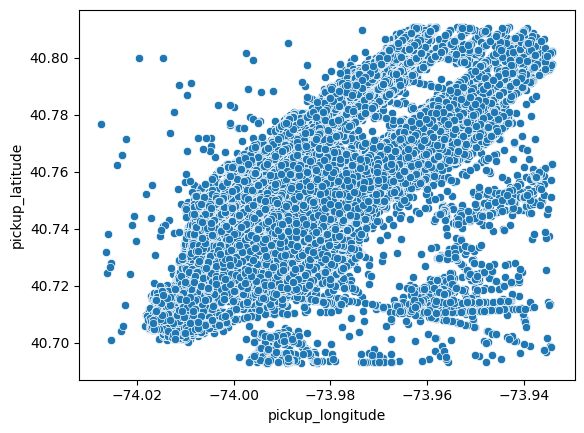

In [101]:
sns.scatterplot(df, x='pickup_longitude', y='pickup_latitude')
plt.show()

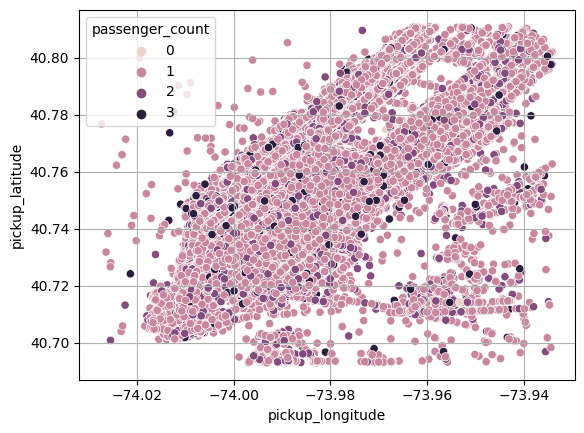

In [80]:
sns.scatterplot(df, x='pickup_longitude', y='pickup_latitude', hue = 'passenger_count')
plt.grid()
plt.show()

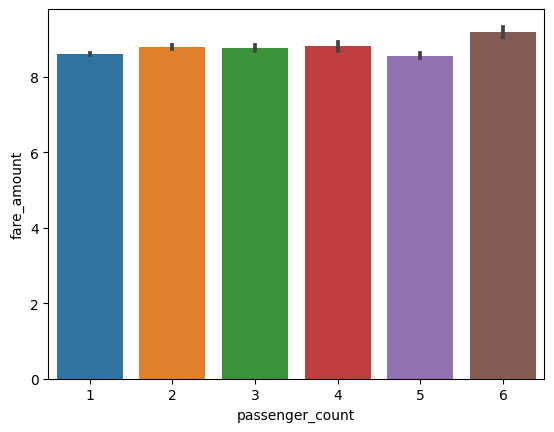

In [102]:
sns.barplot(x="passenger_count", y = "fare_amount", data = df)
plt.show()

# Working with Datetime

In [38]:
df_year = df.copy()

df_year['year'] = df['pickup_datetime'].dt.year

sns.violinplot(x = 'year', y = 'fare_amount', data = df_year, palette = "Set3")
sns.set(rc={'figure.figsize':(20,15)})

In [39]:
sns.barplot(x = 'year', y = 'fare_amount', data = df_year, hue = "passenger_count", ci = None, palette = "husl")
sns.set(rc = {'figure.figsize':(18, 6)})
plt.grid(True)
plt.title('Year vs Fare_amount based on Each Year')
plt.tight_layout()
plt.show()

In [40]:
year_avg = df_year.groupby(['year'], as_index = False)['fare_amount'].mean()
year_avg

,year,fare_amount
0,2009,7.971097
1,2010,8.022853
2,2011,8.141455
3,2012,8.614573
4,2013,9.375291
5,2014,9.494714
6,2015,9.438519


In [41]:
sns.relplot(x = 'year', y = 'fare_amount', data = year_avg, kind = 'line', marker = '*')
plt.show()

In [42]:
import geopandas as gpd
from geopandas import GeoDataFrame
from shapely.geometry import Point, Polygon

In [43]:
geolocation = [Point(x,y) for x,y in zip(df['pickup_longitude'], df['pickup_latitude'])]
geolocation[:5]

[<POINT (-74 40.738)>,
 <POINT (-73.994 40.728)>,
 <POINT (-74.005 40.741)>,
 <POINT (-73.976 40.791)>,
 <POINT (-73.969 40.756)>]

In [44]:
geo_df = GeoDataFrame(df, geometry=geolocation, crs={'init':'epsg:4326'})
geo_df.sample(5)

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,geometry
104845,8.0,2015-01-17 21:55:00,-73.996277,40.723679,-74.009819,40.735386,1,POINT (-73.99628 40.72368)
36406,11.5,2013-03-07 22:10:00,-74.001886,40.732431,-74.000607,40.761549,1,POINT (-74.00189 40.73243)
35639,9.5,2014-12-19 19:54:00,-73.988477,40.723360,-74.002397,40.734432,1,POINT (-73.98848 40.72336)
159685,6.5,2014-04-02 15:17:00,-73.981337,40.773812,-73.984582,40.760065,1,POINT (-73.98134 40.77381)
151951,6.9,2011-08-26 14:29:00,-73.994863,40.765688,-73.988325,40.752468,1,POINT (-73.99486 40.76569)


In [45]:

world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

geo_df.plot(ax=world.plot(figsize=(20, 10)), marker='o', color='red', markersize=50)

plt.title("Geo Location of Provided Co-ordinates in World Map")

plt.show()

In [46]:
# above figure converted in a Plotly scatter plot
fig = go.Figure()

# Plot world map
fig.add_trace(go.Scattergeo(
    lon = world.centroid.x,
    lat = world.centroid.y,
    mode = 'markers',
    marker = dict(
        size = 20,
        color = 'rgba(255, 0, 0, 0.7)',
        line = dict(
            width = 1,
            color = 'rgba(0, 0, 0, 0.7)'
        )
    )
))

# Customize layout
fig.update_geos(projection_type="natural earth")
fig.update_layout(
    title="Geo Location of Provided Co-ordinates in World Map",
    geo=dict(
        showland=True,
        landcolor="rgb(212, 212, 212)",
        countrycolor="rgb(255, 255, 255)",
        coastlinecolor="rgb(255, 255, 255)",
        showframe=False,
        projection_type="equirectangular"
    )
)

# Show the Plotly figure
fig.show()

In [ ]:
import datetime
import plotly.express as px
import plotly.graph_objects as go

#distance wrt lat/long
import geopy.distance


In [ ]:
fig = px.scatter_mapbox(df, lat = 'pickup_latitude', lon = 'pickup_longitude', color= 'passenger_count', size="passenger_count",
title = "Pickup Locations", color_discrete_sequence=["fuchsia"], zoom=11, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


In [ ]:
df1 = df[['pickup_latitude', 'pickup_longitude']]
df1['location'] = 'pickup'
df1.rename(columns = {'pickup_longitude':'longitude', 'pickup_latitude': 'latitude'}, inplace = True)
print(df1.head())

df2 = df[['dropoff_latitude', 'dropoff_longitude']]
df2['location']='dropoff'
df2.rename(columns = {'dropoff_longitude':'longitude', 'dropoff_latitude': 'latitude'}, inplace = True)
print("\n\n",df2.head())

    latitude  longitude location
0  40.738354 -73.999817   pickup
1  40.728225 -73.994355   pickup
2  40.740770 -74.005043   pickup
3  40.790844 -73.976124   pickup
5  40.755910 -73.969019   pickup


     latitude  longitude location
0  40.723217 -73.999512  dropoff
1  40.750325 -73.994710  dropoff
2  40.772647 -73.962565  dropoff
3  40.803349 -73.965316  dropoff
5  40.755910 -73.969019  dropoff


In [ ]:
df_merged = pd.concat([df1, df2])
df_merged['location'].replace(
    ['pickup', 'dropoff'],
    [0, 1], inplace=True)
print(df_merged.shape)
df_merged.sample(5)

(332520, 3)


,latitude,longitude,location
156324,40.720216,-74.010377,1
42277,40.729923,-73.987247,1
130440,40.756572,-73.980856,1
182191,40.720858,-73.997742,1
166774,40.783862,-73.981507,0


In [ ]:
fig = px.scatter_mapbox(df_merged, lat = 'latitude', lon = 'longitude', color= 'location',
title = "Uber Pickup Location", color_discrete_sequence=["fuchsia"], zoom=15, height=500)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

# Fare analysis

In [151]:
import geopy.distance

In [152]:
df_distance = df.copy()
df_distance['pickup_coordinate'] = df[['pickup_latitude', 'pickup_longitude']].apply(tuple, axis=1)
df_distance['dropoff_coordinate'] = df[['dropoff_latitude', 'dropoff_longitude']].apply(tuple, axis=1)

In [153]:
coordinate1 = df_distance['pickup_coordinate'].tolist()
coordinate2 = df_distance['dropoff_coordinate'].tolist()


In [156]:
dist = []
for i,j in zip(coordinate1, coordinate2):
  dis = geopy.distance.geodesic(i, j).km
  dist.append(round(dis,3))

df_distance['distance'] = dist

In [157]:
df_distance['distance'][:5]

0    1.681
1    2.454
2    5.040
3    1.661
5    0.000
Name: distance, dtype: float64

In [158]:
df_distance.sample(5)

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,pickup_coordinate,dropoff_coordinate,distance
21964,11.0,2014-06-10 22:25:00,-73.969182,40.790082,-73.992947,40.757925,1,"(40.790082, -73.96918199999999)","(40.757925, -73.992947)",4.096
188828,13.0,2013-04-20 23:54:00,-73.981097,40.741582,-73.978023,40.783627,5,"(40.741582, -73.98109699999999)","(40.783627, -73.978023)",4.676
158618,5.7,2011-02-15 08:50:00,-73.988312,40.738423,-73.975137,40.749963,1,"(40.738423, -73.988312)","(40.749963, -73.975137)",1.697
16960,4.0,2014-04-26 16:48:00,-74.009146,40.713502,-74.005150,40.720377,1,"(40.713502000000005, -74.009146)","(40.720377, -74.00515)",0.835
178022,7.0,2015-06-11 06:13:00,-73.995087,40.749645,-73.976799,40.756214,1,"(40.7496452331543, -73.99508666992188)","(40.7562141418457, -73.97679901123048)",1.708


In [159]:
df_distance[(df_distance.pickup_longitude == df_distance['dropoff_longitude']) &
            (df_distance.pickup_latitude == df_distance['dropoff_latitude'])]


,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,pickup_coordinate,dropoff_coordinate,distance
5,4.9,2011-02-12 02:27:00,-73.969019,40.755910,-73.969019,40.755910,1,"(40.75591, -73.96901899999999)","(40.75591, -73.96901899999999)",0.0
166,4.5,2014-01-22 21:01:00,-73.992937,40.757780,-73.992937,40.757780,1,"(40.75778, -73.992937)","(40.75778, -73.992937)",0.0
467,4.9,2011-01-10 10:14:00,-74.002718,40.760635,-74.002718,40.760635,2,"(40.760635, -74.002718)","(40.760635, -74.002718)",0.0
733,6.9,2010-05-01 13:06:00,-73.992287,40.721032,-73.992287,40.721032,5,"(40.721032, -73.992287)","(40.721032, -73.992287)",0.0
1052,6.1,2010-05-17 11:22:00,-73.970428,40.761733,-73.970428,40.761733,2,"(40.761733, -73.970428)","(40.761733, -73.970428)",0.0
...,...,...,...,...,...,...,...,...,...,...
198788,5.3,2009-08-14 13:05:00,-73.979123,40.752760,-73.979123,40.752760,2,"(40.75276, -73.979123)","(40.75276, -73.979123)",0.0
198932,2.5,2012-04-03 08:21:00,-73.984616,40.732570,-73.984616,40.732570,4,"(40.73257, -73.984616)","(40.73257, -73.984616)",0.0
199432,8.5,2011-10-24 16:14:00,-74.009728,40.720796,-74.009728,40.720796,1,"(40.720796, -74.00972800000001)","(40.720796, -74.00972800000001)",0.0
199612,4.5,2013-02-17 11:27:00,-73.969717,40.765832,-73.969717,40.765832,3,"(40.765832, -73.969717)","(40.765832, -73.969717)",0.0


In [161]:
df_distance['fare per km'] = round(df_distance['fare_amount'] / df_distance['distance'], 3)
df_distance.sample(5)

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,pickup_coordinate,dropoff_coordinate,distance,fare per km
184809,6.9,2010-03-10 23:03:00,-73.998696,40.729671,-74.006374,40.739582,2,"(40.729671, -73.998696)","(40.739582, -74.006374)",1.277,5.403
164493,5.0,2013-05-04 22:56:00,-74.000655,40.747132,-73.992892,40.748535,6,"(40.747132, -74.00065500000001)","(40.748535, -73.992892)",0.674,7.418
196593,20.5,2011-05-05 15:16:00,-73.956185,40.784468,-73.986868,40.738955,3,"(40.784468, -73.95618499999999)","(40.738955, -73.986868)",5.680,3.609
22784,12.5,2015-06-19 20:32:00,-73.995934,40.764259,-73.957977,40.770313,5,"(40.764259338378906, -73.99593353271484)","(40.77031326293945, -73.95797729492188)",3.274,3.818
51034,6.1,2010-08-13 18:47:00,-73.986623,40.738732,-73.992012,40.727432,1,"(40.738732, -73.986623)","(40.727432, -73.992012)",1.335,4.569


In [162]:
df_distance.replace([np.inf, -np.inf], 0, inplace=True)

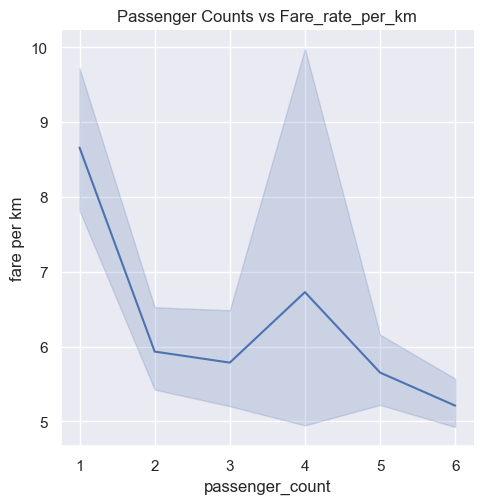

In [165]:
sns.relplot(x="passenger_count", y = "fare per km", kind = 'line', data = df_distance)
plt.title("Passenger Counts vs Fare_rate_per_km")
plt.show()

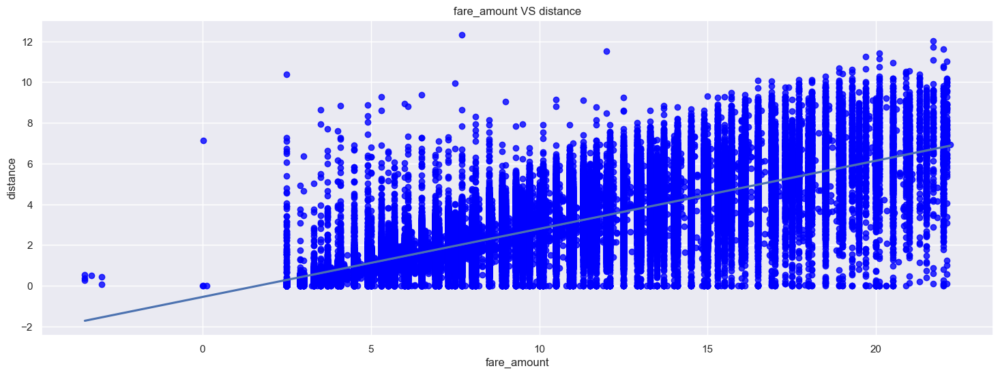

In [166]:
sns.regplot( x = "fare_amount", y="distance", data = df_distance, scatter_kws = {'color' : 'blue'})
plt.title("fare_amount VS distance")
plt.show()

Text(0.5, 1.0, 'passenger_count vs distance')

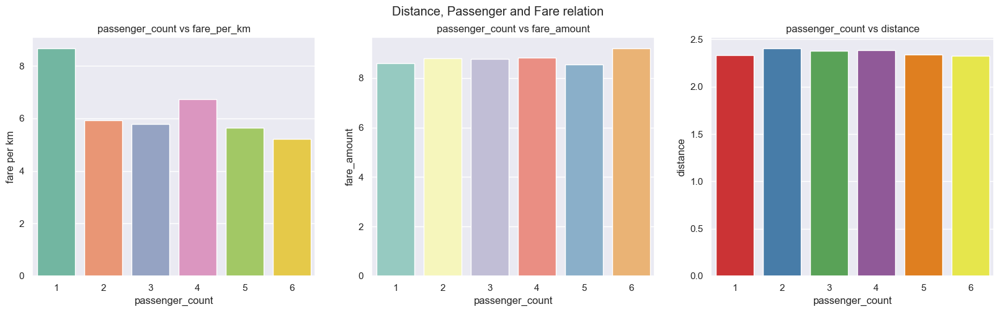

In [170]:
fig, axes = plt.subplots(1, 3, sharex=True, figsize=(20,5))
fig.suptitle('Distance, Passenger and Fare relation')

sns.barplot(ax=axes[0],x="passenger_count", y = "fare per km",data = df_distance, ci = None, palette = "Set2")
axes[0].set_title('passenger_count vs fare_per_km')
sns.barplot(ax=axes[1],x="passenger_count", y = "fare_amount", data = df_distance, ci = None, palette = "Set3")
axes[1].set_title('passenger_count vs fare_amount')
sns.barplot(ax=axes[2],x="passenger_count", y = "distance", data = df_distance,  ci = None, palette = "Set1")
axes[2].set_title('passenger_count vs distance')

ModuleNotFoundError: No module named 'imblearn'

In [ ]:
# #dataframe
# import pandas as pd
# #mathemetical computing
# import numpy as np

# #visualization
# import matplotlib.pyplot as plt
# import seaborn as sns

# #geo location
# import geopandas as gpd
# from geopandas import GeoDataFrame
# from shapely.geometry import Point, Polygon

# #for plotly
# import plotly.express as px
# import plotly.graph_objects as go
# #distance wrt lat/long
# import geopy.distance
# #for datetime to numeric conversion using strftime
# import datetime

# #data preprocessing
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import StandardScaler

# #splitting dataset, sampling and normalization
# from sklearn.model_selection import train_test_split
# from imblearn.over_sampling import SMOTE
# from sklearn.preprocessing import StandardScaler

# #different types of regression model
# from sklearn.linear_model import LinearRegression, Lasso, Ridge
# from sklearn.neighbors import KNeighborsRegressor
# from xgboost import XGBRegressor
# from sklearn.ensemble import RandomForestRegressor

# #error
# from sklearn.metrics import mean_absolute_error
# #accuracy and R1
# from sklearn.metrics import r2_score, explained_variance_score

# #best parameters for hyperparameter tuning
# from sklearn.model_selection import GridSearchCV
# #evaluation of dataset
# from sklearn.model_selection import StratifiedKFold

# #save model
# import joblib
# #remove warning
# import warnings
# warnings.filterwarnings("ignore")